In [1]:
from tqdm import tqdm
from IPython.display import HTML

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

import torch
import torch.nn as nn
from torch.utils.data import DataLoader
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils

from torch import Tensor

In [2]:
mnist_data = dset.MNIST(
    root='../../datasets',
    download=False,
    train=True,
    transform=transforms.Compose([
        transforms.ToTensor()
    ])
)

dataloader = DataLoader(mnist_data, batch_size=256, shuffle=True)

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

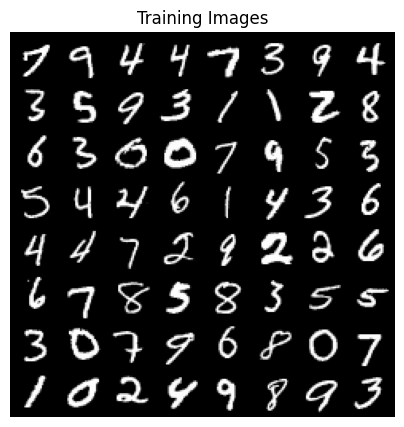

In [4]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(5,5))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [5]:
class Generator(nn.Module):
    def __init__(self, latent_dim=100, n_channels=1, img_s=28):
        super().__init__()
        self.generator = nn.Sequential(
            # 100 x 1 x 1 -> img_s * 8 x 7 x 7
            nn.ConvTranspose2d(latent_dim, img_s * 4, kernel_size=7, bias=False),
            nn.BatchNorm2d(img_s * 4),
            nn.ReLU(inplace=True),
            # img_s * 8 x 7 x 7 -> img_s * 4 x 14 x 14
            nn.ConvTranspose2d(img_s * 4, img_s * 2, kernel_size=2, stride=2),
            nn.BatchNorm2d(img_s * 2),
            nn.ReLU(inplace=True),
            # img_s * 4 x 14 x 14 -> 1 x 28 x 28
            nn.ConvTranspose2d(img_s * 2, n_channels, kernel_size=2, stride=2),
            nn.Tanh()
        )

    def forward(self, z: Tensor):
        return self.generator(z)

In [6]:
class Discriminator(nn.Module):
    def __init__(self, n_channels=1, img_s=28):
        super().__init__()
        self.discriminator = nn.Sequential(
            nn.Conv2d(n_channels, img_s * 2, kernel_size=2, stride=2, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(img_s * 2, img_s * 4, kernel_size=2, stride=2, bias=False),
            nn.BatchNorm2d(img_s * 4),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(img_s * 4, img_s * 8, kernel_size=2, stride=2, bias=2),
            nn.BatchNorm2d(img_s * 8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(img_s * 8, 1, kernel_size=3, stride=1, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x: Tensor):
        return self.discriminator(x)

In [7]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

n_channels = 1
img_s = 28
latent_dim = 100
batch_size = 256


lr = 0.0002
epochs = 30
beta1, beta2 = (0.5, 0.999)
real_label = 1
fake_label = 0
iters = 0

fixed_noise = torch.randn(64, latent_dim, 1, 1, device=device)

In [8]:
generator = Generator(latent_dim, n_channels, img_s).to(device)
discriminator = Discriminator(n_channels, img_s).to(device)

loss_fn = nn.BCELoss()

optimizerG = optim.Adam(generator.parameters(), lr=lr, betas=(beta1, beta2))
optimizerD = optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, beta2))

In [9]:
img_list = []

for epoch in tqdm(range(epochs)):
    for i, (x, _) in enumerate(dataloader):
        x: Tensor = x.to(device)
        x_batch = x.shape[0]
        # D
        # with real
        discriminator.zero_grad()
        labels = torch.full((x_batch, ), fill_value=real_label, dtype=torch.float, device=device)
        D_output = discriminator(x).view(-1)
        D_error_real: Tensor = loss_fn(D_output, labels)
        D_error_real.backward()

        # with fake
        z = torch.randn(x_batch, latent_dim, 1, 1, device=device)
        x_bar = generator(z)
        labels.fill_(fake_label)
        D_output = discriminator(x_bar).view(-1)
        D_error_fake: Tensor = loss_fn(D_output, labels)
        D_error_fake.backward(retain_graph=True)

        D_error = D_error_real + D_error_fake
        optimizerD.step()

        # G
        generator.zero_grad()
        labels.fill_(real_label)
        D_output = discriminator(x_bar).view(-1)
        G_error: Tensor = loss_fn(D_output, labels)
        G_error.backward()
        optimizerG.step()

        if i % 100 == 0:
            print(f'Epoch [{epoch}/{epochs}] Batch {i}/{len(dataloader)} Loss D: {D_error.item()} Loss G: {G_error.item()}')

        if (iters % 100 == 0) or (i % 50 == 0) or ((epoch == epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = generator(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

  0%|          | 0/30 [00:00<?, ?it/s]

Epoch [0/30] Batch 0/235 Loss D: 1.3874843120574951 Loss G: 0.7406962513923645
Epoch [0/30] Batch 100/235 Loss D: 0.1607455015182495 Loss G: 2.843851327896118
Epoch [0/30] Batch 200/235 Loss D: 0.06664717197418213 Loss G: 4.009293556213379


  3%|▎         | 1/30 [02:18<1:06:59, 138.59s/it]

Epoch [1/30] Batch 0/235 Loss D: 0.09939966350793839 Loss G: 4.532899379730225
Epoch [1/30] Batch 100/235 Loss D: 0.04269151762127876 Loss G: 4.720258712768555
Epoch [1/30] Batch 200/235 Loss D: 0.02485451102256775 Loss G: 5.405529022216797


  7%|▋         | 2/30 [04:31<1:03:14, 135.51s/it]

Epoch [2/30] Batch 0/235 Loss D: 0.10382188856601715 Loss G: 5.24207067489624
Epoch [2/30] Batch 100/235 Loss D: 0.13757632672786713 Loss G: 3.72209095954895
Epoch [2/30] Batch 200/235 Loss D: 0.12111517786979675 Loss G: 3.728947639465332


 10%|█         | 3/30 [06:41<59:47, 132.88s/it]  

Epoch [3/30] Batch 0/235 Loss D: 0.47084841132164 Loss G: 1.6593775749206543
Epoch [3/30] Batch 100/235 Loss D: 0.12596836686134338 Loss G: 3.1005783081054688
Epoch [3/30] Batch 200/235 Loss D: 0.18435251712799072 Loss G: 2.894906759262085


 13%|█▎        | 4/30 [08:49<56:45, 131.00s/it]

Epoch [4/30] Batch 0/235 Loss D: 0.24873685836791992 Loss G: 3.347720146179199
Epoch [4/30] Batch 100/235 Loss D: 0.1500249207019806 Loss G: 3.297377586364746
Epoch [4/30] Batch 200/235 Loss D: 0.1205061823129654 Loss G: 3.197329044342041


 17%|█▋        | 5/30 [10:38<51:15, 123.01s/it]

Epoch [5/30] Batch 0/235 Loss D: 0.10916973650455475 Loss G: 3.491692304611206
Epoch [5/30] Batch 100/235 Loss D: 0.09256177395582199 Loss G: 3.4757776260375977
Epoch [5/30] Batch 200/235 Loss D: 0.23811541497707367 Loss G: 2.677990674972534


 20%|██        | 6/30 [12:17<45:57, 114.88s/it]

Epoch [6/30] Batch 0/235 Loss D: 0.20549894869327545 Loss G: 2.283090114593506
Epoch [6/30] Batch 100/235 Loss D: 0.4457819163799286 Loss G: 2.0672919750213623
Epoch [6/30] Batch 200/235 Loss D: 0.13702644407749176 Loss G: 3.715311288833618


 23%|██▎       | 7/30 [14:03<42:56, 112.03s/it]

Epoch [7/30] Batch 0/235 Loss D: 0.10052275657653809 Loss G: 3.8111331462860107
Epoch [7/30] Batch 100/235 Loss D: 0.06287484616041183 Loss G: 3.8570730686187744
Epoch [7/30] Batch 200/235 Loss D: 0.4656803607940674 Loss G: 2.0428578853607178


 27%|██▋       | 8/30 [15:47<40:02, 109.23s/it]

Epoch [8/30] Batch 0/235 Loss D: 0.2534441649913788 Loss G: 2.8873417377471924
Epoch [8/30] Batch 100/235 Loss D: 0.0983039140701294 Loss G: 3.319945812225342
Epoch [8/30] Batch 200/235 Loss D: 0.0805000588297844 Loss G: 3.5271153450012207


 30%|███       | 9/30 [17:32<37:45, 107.88s/it]

Epoch [9/30] Batch 0/235 Loss D: 0.052853070199489594 Loss G: 4.443212032318115
Epoch [9/30] Batch 100/235 Loss D: 0.0876251608133316 Loss G: 2.5444586277008057
Epoch [9/30] Batch 200/235 Loss D: 0.181099072098732 Loss G: 2.929020404815674


 33%|███▎      | 10/30 [19:07<34:38, 103.92s/it]

Epoch [10/30] Batch 0/235 Loss D: 0.129769966006279 Loss G: 3.2663915157318115
Epoch [10/30] Batch 100/235 Loss D: 0.2898229956626892 Loss G: 2.4890639781951904
Epoch [10/30] Batch 200/235 Loss D: 0.08543404936790466 Loss G: 3.866570234298706


 37%|███▋      | 11/30 [20:56<33:25, 105.55s/it]

Epoch [11/30] Batch 0/235 Loss D: 0.07733666896820068 Loss G: 3.516636610031128
Epoch [11/30] Batch 100/235 Loss D: 0.8835886716842651 Loss G: 1.0744812488555908
Epoch [11/30] Batch 200/235 Loss D: 0.15593884885311127 Loss G: 3.028029203414917


 40%|████      | 12/30 [22:38<31:23, 104.66s/it]

Epoch [12/30] Batch 0/235 Loss D: 0.10001878440380096 Loss G: 3.3947458267211914
Epoch [12/30] Batch 100/235 Loss D: 0.6012464761734009 Loss G: 1.730127215385437
Epoch [12/30] Batch 200/235 Loss D: 0.1054215356707573 Loss G: 3.439889430999756


 43%|████▎     | 13/30 [24:09<28:26, 100.37s/it]

Epoch [13/30] Batch 0/235 Loss D: 0.0743178129196167 Loss G: 3.645576238632202
Epoch [13/30] Batch 100/235 Loss D: 0.08230277895927429 Loss G: 3.539491653442383
Epoch [13/30] Batch 200/235 Loss D: 0.18068401515483856 Loss G: 2.9772045612335205


 47%|████▋     | 14/30 [25:39<25:56, 97.29s/it] 

Epoch [14/30] Batch 0/235 Loss D: 0.1119999811053276 Loss G: 3.373518466949463
Epoch [14/30] Batch 100/235 Loss D: 0.07391482591629028 Loss G: 4.063756465911865
Epoch [14/30] Batch 200/235 Loss D: 0.13165509700775146 Loss G: 3.4122397899627686


 50%|█████     | 15/30 [27:04<23:22, 93.51s/it]

Epoch [15/30] Batch 0/235 Loss D: 0.11040004342794418 Loss G: 3.5686380863189697
Epoch [15/30] Batch 100/235 Loss D: 0.2526945173740387 Loss G: 7.119447231292725
Epoch [15/30] Batch 200/235 Loss D: 0.08336681127548218 Loss G: 4.1210036277771


 53%|█████▎    | 16/30 [28:28<21:10, 90.78s/it]

Epoch [16/30] Batch 0/235 Loss D: 0.05994974076747894 Loss G: 3.857009172439575
Epoch [16/30] Batch 100/235 Loss D: 0.2244037687778473 Loss G: 3.0046157836914062
Epoch [16/30] Batch 200/235 Loss D: 0.07821539044380188 Loss G: 3.747213840484619


 57%|█████▋    | 17/30 [29:58<19:34, 90.33s/it]

Epoch [17/30] Batch 0/235 Loss D: 1.191591501235962 Loss G: 7.555196762084961
Epoch [17/30] Batch 100/235 Loss D: 0.057898346334695816 Loss G: 4.643964767456055
Epoch [17/30] Batch 200/235 Loss D: 0.0611981526017189 Loss G: 4.504040718078613


 60%|██████    | 18/30 [31:34<18:24, 92.05s/it]

Epoch [18/30] Batch 0/235 Loss D: 0.14519503712654114 Loss G: 3.1753621101379395
Epoch [18/30] Batch 100/235 Loss D: 0.07075675576925278 Loss G: 4.020522594451904
Epoch [18/30] Batch 200/235 Loss D: 0.050307415425777435 Loss G: 4.327320575714111


 63%|██████▎   | 19/30 [33:15<17:24, 94.95s/it]

Epoch [19/30] Batch 0/235 Loss D: 0.04219885170459747 Loss G: 4.63630485534668
Epoch [19/30] Batch 100/235 Loss D: 0.22730642557144165 Loss G: 2.7315821647644043
Epoch [19/30] Batch 200/235 Loss D: 0.0982431024312973 Loss G: 3.6645779609680176


 67%|██████▋   | 20/30 [34:49<15:45, 94.51s/it]

Epoch [20/30] Batch 0/235 Loss D: 0.09173734486103058 Loss G: 4.22744607925415
Epoch [20/30] Batch 100/235 Loss D: 0.12445947527885437 Loss G: 3.670891761779785
Epoch [20/30] Batch 200/235 Loss D: 0.07369934022426605 Loss G: 4.587913990020752


 70%|███████   | 21/30 [36:14<13:45, 91.72s/it]

Epoch [21/30] Batch 0/235 Loss D: 0.11710759997367859 Loss G: 5.345592498779297
Epoch [21/30] Batch 100/235 Loss D: 0.20044957101345062 Loss G: 0.9375680088996887
Epoch [21/30] Batch 200/235 Loss D: 0.16766056418418884 Loss G: 3.5282652378082275


 73%|███████▎  | 22/30 [37:42<12:03, 90.48s/it]

Epoch [22/30] Batch 0/235 Loss D: 0.10368896275758743 Loss G: 3.923210620880127
Epoch [22/30] Batch 100/235 Loss D: 0.0479721799492836 Loss G: 4.839117527008057
Epoch [22/30] Batch 200/235 Loss D: 0.04928220808506012 Loss G: 4.556018829345703


 77%|███████▋  | 23/30 [39:08<10:23, 89.11s/it]

Epoch [23/30] Batch 0/235 Loss D: 0.03657280281186104 Loss G: 4.439873695373535
Epoch [23/30] Batch 100/235 Loss D: 0.21053040027618408 Loss G: 3.2787065505981445
Epoch [23/30] Batch 200/235 Loss D: 0.09470856189727783 Loss G: 3.6540117263793945


 80%|████████  | 24/30 [40:32<08:46, 87.70s/it]

Epoch [24/30] Batch 0/235 Loss D: 0.058446407318115234 Loss G: 4.4573845863342285
Epoch [24/30] Batch 100/235 Loss D: 0.06184312701225281 Loss G: 4.718141555786133
Epoch [24/30] Batch 200/235 Loss D: 0.18359720706939697 Loss G: 2.9823598861694336


 83%|████████▎ | 25/30 [42:07<07:29, 89.81s/it]

Epoch [25/30] Batch 0/235 Loss D: 0.159755676984787 Loss G: 4.056974411010742
Epoch [25/30] Batch 100/235 Loss D: 0.06200043112039566 Loss G: 4.029784679412842
Epoch [25/30] Batch 200/235 Loss D: 0.034530043601989746 Loss G: 4.3191118240356445


 87%|████████▋ | 26/30 [43:40<06:03, 90.79s/it]

Epoch [26/30] Batch 0/235 Loss D: 0.2392870932817459 Loss G: 2.95735502243042
Epoch [26/30] Batch 100/235 Loss D: 0.06374802440404892 Loss G: 4.272024631500244
Epoch [26/30] Batch 200/235 Loss D: 0.06226819008588791 Loss G: 4.697332859039307


 90%|█████████ | 27/30 [45:16<04:36, 92.29s/it]

Epoch [27/30] Batch 0/235 Loss D: 0.045323509722948074 Loss G: 4.723177909851074
Epoch [27/30] Batch 100/235 Loss D: 0.29368776082992554 Loss G: 2.6619303226470947
Epoch [27/30] Batch 200/235 Loss D: 0.20015276968479156 Loss G: 2.420758008956909


 93%|█████████▎| 28/30 [47:00<03:11, 95.94s/it]

Epoch [28/30] Batch 0/235 Loss D: 0.0886511504650116 Loss G: 3.5167300701141357
Epoch [28/30] Batch 100/235 Loss D: 0.09603516757488251 Loss G: 4.034552574157715
Epoch [28/30] Batch 200/235 Loss D: 0.055913880467414856 Loss G: 4.280605316162109


 97%|█████████▋| 29/30 [48:36<01:35, 95.79s/it]

Epoch [29/30] Batch 0/235 Loss D: 0.04016498103737831 Loss G: 4.601746082305908
Epoch [29/30] Batch 100/235 Loss D: 0.045479126274585724 Loss G: 5.21417236328125
Epoch [29/30] Batch 200/235 Loss D: 0.04585276171565056 Loss G: 4.779140949249268


100%|██████████| 30/30 [50:12<00:00, 100.42s/it]


We trained a Generative Adversarial Network (GAN) on the MNIST dataset for 30 epochs. Training GANs can be challenging and often requires more epochs to achieve better results. The images generated in this experiment may not be of high quality due to the limited number of training epochs.

Animation size has reached 21269024 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


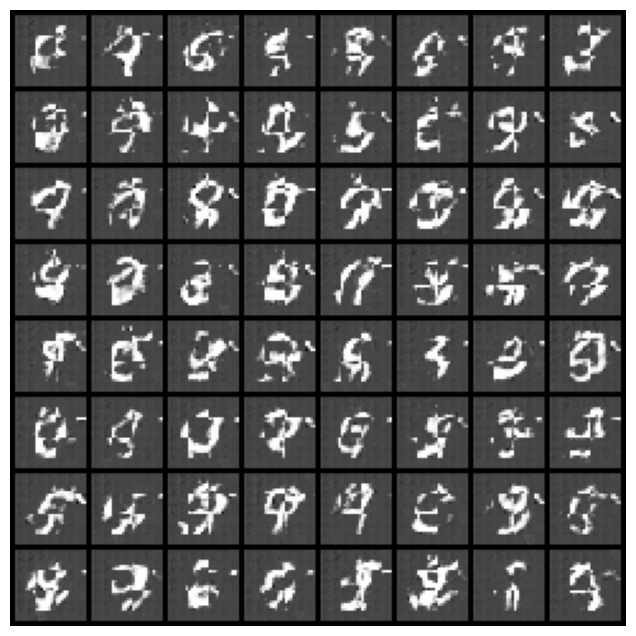

In [10]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())